#Final Project
###In-Depth Analysis of Local Government Public Meetings Transcripts
Daniel Geyshis I.D: 203376298

Hila Ashkenazi I.D: 208953083



Dateset used for meetings data - https://localview.net

Dataset of counties - https://github.com/kjhealy/us-county/blob/master/data/geojson/gz_2010_us_040_00_500k.json

instructions - https://moodle.bgu.ac.il/moodle/pluginfile.php/3869940/mod_resource/content/1/%D7%94%D7%A0%D7%97%D7%99%D7%95%D7%AA%20%D7%A4%D7%A8%D7%95%D7%99%D7%A7%D7%98%20-%202023.pdf

example project - https://arxiv.org/pdf/2007.08630.pdf

## Data loading

In [1]:
import os
from google.colab import drive
drive.mount('/content/drive')
folder_path = '/content/drive/MyDrive/big_data_mining/final_project'
files_base_path = folder_path + '/dataverse_files'
file_list = os.listdir(files_base_path)
for file_name in file_list:
    print(file_name)

Mounted at /content/drive
meetings.2008.csv
meetings.2010.csv
meetings.2009.csv
meetings.2012.csv
meetings.2017.csv
meetings.2011.csv
meetings.2013.csv
meetings.2006.csv
meetings.2007.csv
meetings.2014.csv
meetings.2016.csv
meetings.2015.csv


In [2]:
import pandas as pd
def load_meeting_file_to_df(file_name):
  file_path = f'{files_base_path}/{file_name}'
  sep = ',' if '2017' not in file else '|'
  df = pd.read_csv(file_path,sep=sep)
  return df


In [3]:
dfs = {}
for file in file_list:
    dfs[file] = load_meeting_file_to_df(file)


Data overview , missing values and more

In [4]:
def take_relvent_colls(dfs,colls):
  res= {}
  for filename,df in dfs.items():
    res[filename] = df[colls]
  return res

In [5]:
def dfs_in_detail(dfs):
  for filename,df in dfs.items():
    print(filename)
    df.info()
    print("-------------------------------------")

In [6]:
dfs_in_detail(dfs)

meetings.2008.csv
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 106 entries, 0 to 105
Data columns (total 36 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   st_fips                  106 non-null    int64  
 1   state_name               106 non-null    object 
 2   place_name               106 non-null    object 
 3   place_govt               106 non-null    object 
 4   place_Pres_dem2pv        106 non-null    float64
 5   place_Pres_dem2pv_last   106 non-null    float64
 6   place_Gov_dem2pv         2 non-null      float64
 7   place_Gov_dem2pv_last    2 non-null      float64
 8   place_House_dem2pv       1 non-null      float64
 9   place_House_dem2pv_last  1 non-null      float64
 10  place_Sen_dem2pv         37 non-null     float64
 11  place_Sen_dem2pv_last    37 non-null     float64
 12  census_2010_pop          106 non-null    int64  
 13  census_2010_pop_est      106 non-null    int64  
 14  census_2

### take only the relvent collums , clean and organize the data as needed

In [7]:
rel = take_relvent_colls(dfs,['state_name', 'place_name','meeting_date'])

In [8]:
dfs_in_detail(rel)

meetings.2008.csv
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 106 entries, 0 to 105
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   state_name    106 non-null    object
 1   place_name    106 non-null    object
 2   meeting_date  106 non-null    object
dtypes: object(3)
memory usage: 2.6+ KB
-------------------------------------
meetings.2010.csv
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1684 entries, 0 to 1683
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   state_name    1684 non-null   object
 1   place_name    1684 non-null   object
 2   meeting_date  1684 non-null   object
dtypes: object(3)
memory usage: 39.6+ KB
-------------------------------------
meetings.2009.csv
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 488 entries, 0 to 487
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------  

In [9]:
all_data = pd.concat(rel.values())
all_data['meeting_date'] = pd.to_datetime(all_data['meeting_date'])
all_data.dropna(subset=['state_name', 'place_name', 'meeting_date'], inplace=True)
all_data['meeting_year'] = all_data['meeting_date'].dt.year

### Meeting Frequency by Year

In this code, relevant columns were collected from multiple dataframes and merged into the all_data dataframe. The `'meeting_date'` column was converted to datetime format, and rows with missing values in` 'state_name', 'place_name', 'meeting_date'` were removed. The `'meeting_year'` column was created from the year component of `'meeting_date'`.For visualization, the first plot used Seaborn's `countplot()` to show the frequency of meetings per year. The second plot depicted the top 10 states by meeting frequency using Seaborn's `barplot()`. Both visualizations help to understand the distribution of meetings across years and the top states with the highest meeting frequencies.

In [10]:
all_data

,state_name,place_name,meeting_date,meeting_year
0,Arkansas,Fayetteville city,2008-08-30,2008
1,California,Stockton city,2008-04-22,2008
2,California,Vallejo city,2008-05-06,2008
3,California,Vallejo city,2008-05-06,2008
4,California,Vallejo city,2008-05-06,2008
...,...,...,...,...
10517,Wisconsin,Nekoosa city,2015-05-19,2015
10518,Wisconsin,Nekoosa city,2015-05-19,2015
10519,Wisconsin,Nekoosa city,2015-04-14,2015
10520,Wisconsin,Nekoosa city,2015-02-10,2015


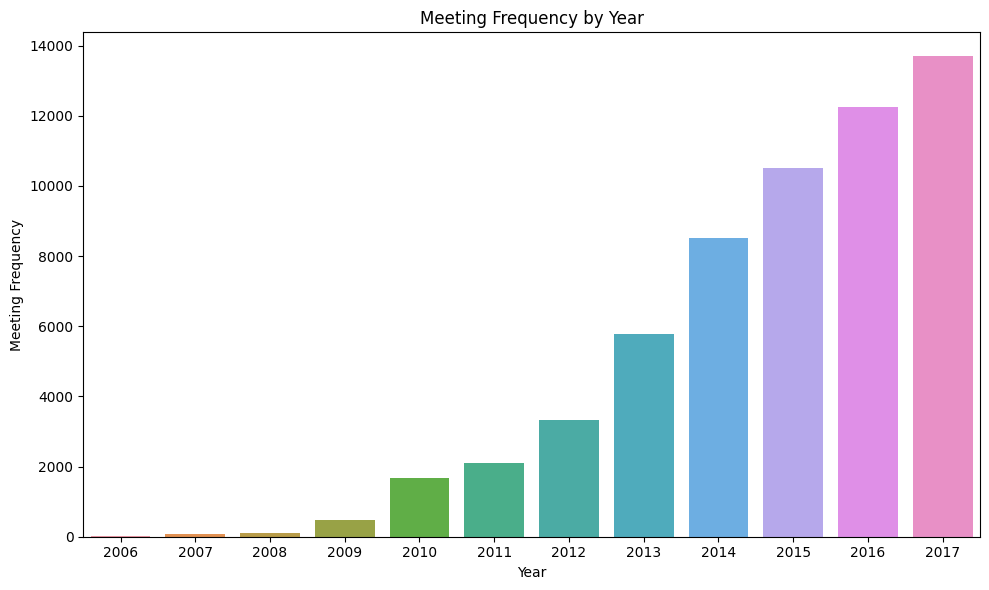

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(10, 6))
sns.countplot(x='meeting_year', data=all_data)
plt.title('Meeting Frequency by Year')
plt.xlabel('Year')
plt.ylabel('Meeting Frequency')
plt.tight_layout()
plt.show()

### Top 10 States by Meeting Frequency

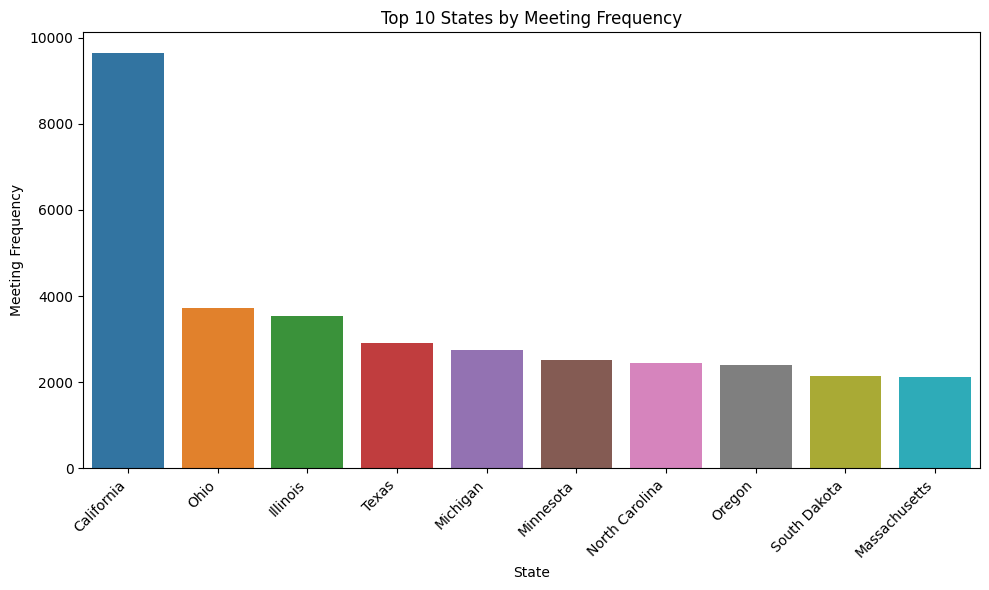

In [12]:
top_states = all_data['state_name'].value_counts().nlargest(10)
plt.figure(figsize=(10, 6))
sns.barplot(x=top_states.index, y=top_states.values)
plt.xticks(rotation=45, ha='right')
plt.title('Top 10 States by Meeting Frequency')
plt.xlabel('State')
plt.ylabel('Meeting Frequency')
plt.tight_layout()
plt.show()

### Frequency of Meetings by State Over Time
this code visualizes the temporal distribution of government committee meetings across US states. We aggregated meeting counts by state and year, loaded a US states GeoJSON file, and created an animated choropleth map using `plotly.express.choropleth()`. The color intensity of each state on the map corresponds to its meeting count, and the animation changes the map over different years.

In [13]:
import geopandas as gpd
import plotly.express as px
meeting_counts = all_data.groupby(['state_name', 'meeting_year']).size().reset_index(name='meeting_count')

gdf_states = gpd.read_file(f'{folder_path}/gz_2010_us_040_00_500k.json')
meeting_counts = meeting_counts.sort_values(by='meeting_year')

fig = px.choropleth(
    meeting_counts,
    geojson=gdf_states,
    locations="state_name",
    featureidkey="properties.NAME",
    color="meeting_count",
    hover_name="state_name",
    hover_data=["meeting_count"],
    animation_frame='meeting_year',
    color_continuous_midpoint=3,
    color_continuous_scale=px.colors.sequential.Plasma,
)

fig.update_layout(
    margin=dict(l=20, r=0, b=0, t=70, pad=0),
    paper_bgcolor="white",
    height=700,
    title_text='Frequency of Meetings by State Over Time',
    font_size=18,
    geo=dict(
        scope='usa',
        center=dict(lat=37.0902, lon=-95.7129),
        projection_scale=1,
    ),
)

fig.show()

##Topic Analysis:
This code involved preprocessing the text data by removing unnecessary elements and then extracting significant topics using part-of-speech tagging and frequency analysis. By constructing a network graph, we established relationships between states and their discussed topics, with edges denoting the importance of each topic. The final step involved visualizing the graph to provide a clear representation of topic distribution and prominence among different states, offering valuable insights into the focus of these committee meetings.

In [14]:
from tqdm import tqdm
tqdm.pandas()

In [ ]:
rel = take_relvent_colls(dfs,['state_name','caption_text_clean'])
df = pd.concat(rel.values()).dropna()
df

,state_name,caption_text_clean
0,Arkansas,{00:00:00} it is exactly like your place on th...
2,California,{00:00:01} Chief Sherman you think this houses...
4,California,{00:00:00} did you have any inkling or expecta...
5,California,{00:00:05} continue with the women's well if t...
6,Minnesota,{00:00:00} ha {00:00:14} {00:00:14} you {00:00...
...,...,...
10507,Wisconsin,{00:00:00} call a Pirate Roberts committee mee...
10512,Wisconsin,{00:00:00} like to call a finance for every {0...
10513,Wisconsin,{00:00:00} I will call the August council meet...
10515,Wisconsin,{00:00:13} good evening I'm going to call the ...


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


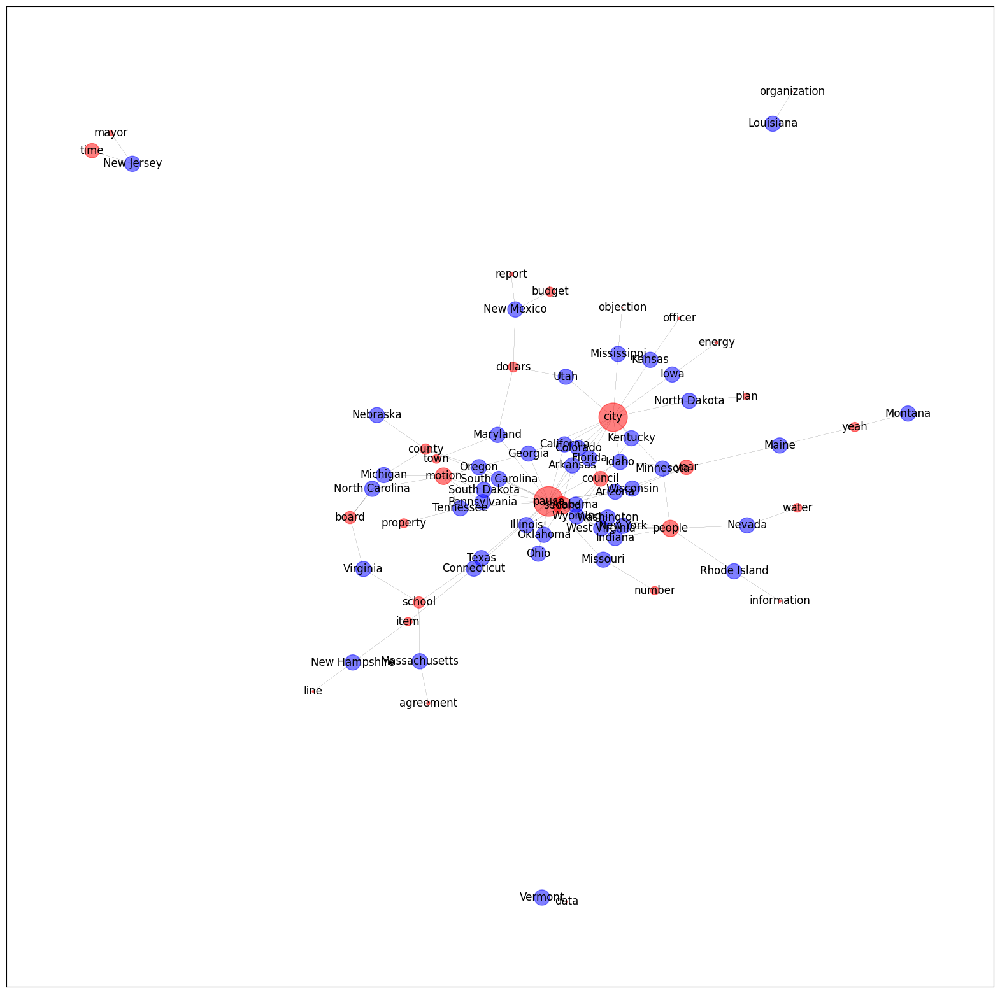

In [ ]:
import pandas as pd
import re
import networkx as nx
import matplotlib.pyplot as plt
from collections import Counter
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.tag import pos_tag
import nltk
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
stop_words = set(stopwords.words('english'))

def process_transcript(transcript):
    cleaned_text = re.sub(r'\{.*?\}', '', transcript)
    return cleaned_text

def extract_topics(text, num_topics=3):
    words = word_tokenize(text)
    words = [word.lower() for word in words if word.isalpha() and word.lower() not in stop_words]
    tagged_words = pos_tag(words)
    nouns = [word for word, pos in tagged_words if pos.startswith('N')]
    topic_counts = Counter(nouns)
    top_topics = topic_counts.most_common(num_topics)

    return [topic[0] for topic in top_topics]


def create_topic_graph(df, max_states=50, max_topics=20):
    graph = nx.Graph()
    topic_counts = Counter()
    state_topic_counts = Counter()

    def process_row(row):
        state = row['state_name']
        text = process_transcript(row['caption_text_clean'])
        topics = extract_topics(text)
        state_topics = Counter(topics)
        topic_counts.update(state_topics)
        state_topic_counts[state] = state_topics

    tqdm.pandas()

    df.progress_apply(process_row, axis=1)
    top_topics = topic_counts.most_common(max_topics)
    top_topic_names = [topic[0] for topic in top_topics]
    for state in tqdm(state_topic_counts.keys(), desc="Building Graph"):
        graph.add_node(state, type='state', size=sum(state_topic_counts[state].values()))
        state_topics = state_topic_counts[state]
        for topic, count in state_topics.items():
            if topic in top_topic_names:
                graph.add_node(topic, type='topic', size=topic_counts[topic])
                graph.add_edge(state, topic, weight=count)

        most_popular_topic = state_topic_counts[state].most_common(1)
        if most_popular_topic:
            most_popular_topic = most_popular_topic[0][0]
            graph.add_node(most_popular_topic, type='topic', size=topic_counts[most_popular_topic])
            graph.add_edge(state, most_popular_topic, weight=1)

    return graph

def visualize_graph(graph):
    state_nodes = [node for node in graph.nodes if graph.nodes[node]['type'] == 'state']
    topic_nodes = [node for node in graph.nodes if graph.nodes[node]['type'] == 'topic']
    state_sizes = [graph.nodes[state]['size'] * 100 for state in state_nodes]
    topic_sizes = [graph.nodes[topic]['size'] * 0.1 for topic in topic_nodes]

    fig, ax = plt.subplots(figsize=(20, 20))
    pos = nx.spring_layout(graph, seed=42, scale=25, fixed=None)
    nx.draw_networkx_nodes(graph, pos, nodelist=state_nodes, node_color='b', alpha=0.5, node_size=state_sizes)
    nx.draw_networkx_nodes(graph, pos, nodelist=topic_nodes,  node_color='r', alpha=0.5, node_size=topic_sizes)
    nx.draw_networkx_edges(graph, pos, width=[0.1 * graph[u][v]['weight'] for u, v in graph.edges])
    node_labels = {node: node for node in graph.nodes}
    nx.draw_networkx_labels(graph, pos, labels=node_labels)

    plt.show()

graph = create_topic_graph(df)
visualize_graph(graph)

##Sentiment Analysis:
Conduct sentiment analysis on meeting transcripts



In this code, we curated relevant columns from multiple dataframes using the `take_relvent_colls()` function and merged them into a single all_data dataframe. The meeting dates were converted to datetime format, and rows with missing values in crucial columns were removed. The `meeting_year` column was created from the meeting dates' year component. By utilizing the NLTK library's `VADER` sentiment analysis tool, sentiment scores were calculated for each `caption_text_clean` entry, and the compound sentiment score was extracted. The script produced two visualizations: the first is a bar plot depicting the average sentiment score per year using average_sentiment_by_year, while the second is a 3D scatter plot created using Plotly Express`px.scatter_3d() `showcasing the sentiment score variation across states and years using `average_sentiment_by_state_year`.

In [15]:
rel = take_relvent_colls(dfs,['vid_desc','vid_title','caption_text_clean','caption_text','state_name', 'place_name','meeting_date'])

In [16]:
dfs_in_detail(rel)

meetings.2008.csv
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 106 entries, 0 to 105
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   vid_desc            105 non-null    object
 1   vid_title           106 non-null    object
 2   caption_text_clean  54 non-null     object
 3   caption_text        54 non-null     object
 4   state_name          106 non-null    object
 5   place_name          106 non-null    object
 6   meeting_date        106 non-null    object
dtypes: object(7)
memory usage: 5.9+ KB
-------------------------------------
meetings.2010.csv
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1684 entries, 0 to 1683
Data columns (total 7 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   vid_desc            1418 non-null   object
 1   vid_title           1684 non-null   object
 2   caption_text_clean  957 non-null    object
 3  

In [21]:
all_data = pd.concat(rel.values())
all_data['meeting_date'] = pd.to_datetime(all_data['meeting_date'])
all_data.dropna(subset=['state_name', 'place_name', 'meeting_date', 'caption_text', 'caption_text_clean'], inplace=True)
all_data['meeting_year'] = all_data['meeting_date'].dt.year

all_data

,vid_desc,vid_title,caption_text_clean,caption_text,state_name,place_name,meeting_date,meeting_year
0,"Eighth segment of August 30, 2011, meeting of ...",DSCN9037Town Branch neighborhood Aug 30 meetin...,{00:00:00} it is exactly like your place on th...,{00:00:00} it is exactly like your place on th...,Arkansas,Fayetteville city,2008-08-30,2008
2,Fire Chief Russ Sherman touches on the issues ...,"Fire Chief Sherman--May 6, 2008 City Council M...",{00:00:01} Chief Sherman you think this houses...,{00:00:01} Chief Sherman you think this houses...,California,Vallejo city,2008-05-06,2008
4,A few words with councilmember Gomes after the...,"Councilmember Stpehanie Gomes--May 6, 2008 Val...",{00:00:00} did you have any inkling or expecta...,{00:00:00} did you have any inkling or expecta...,California,Vallejo city,2008-05-06,2008
5,Osby Davis talks about the unanimous decision ...,"Mayor Osby Davis--May 6, 2008 City Council Mee...",{00:00:05} continue with the women's well if t...,{00:00:05} continue with the women's well if t...,California,Vallejo city,2008-05-06,2008
6,The Robbinsdale District 281 School Board meet...,"District 281, Brooklyn Park meetings tonight -...",{00:00:00} ha {00:00:14} {00:00:14} you {00:00...,{00:00:00} ha {00:00:14} {00:00:14} you {00:00...,Minnesota,Burnsville city,2008-07-06,2008
...,...,...,...,...,...,...,...,...
1661,at City of Glen Rose Town Council Meeting Apri...,Oakdale Park Plan is *Engineering Ready* -Bud ...,{00:00:00} we begin in a pair join this from t...,{00:00:00} we begin in a pair join this from t...,Texas,Rose City city,2010-04-26,2010
1662,at Glen rose Town council meeting April 26 2010,Surls is from Cisco-Likes Historic Parks,{00:00:00} so this moment turned over to put ...,{00:00:00} so this moment turned over to put ...,Texas,Rose City city,2010-04-26,2010
1663,April 26 2010 City Council Meeting Glen Rose,Huckaby-The Oakdale Plan is a work In progress,{00:00:00} and mr. Searles has an extensive b...,{00:00:00} and mr. Searles has an extensive b...,Texas,Rose City city,2010-04-26,2010
1665,at Somervell County Water District Board meeti...,Rod Hale on Lakequarium,{00:00:00} I want to tell you in my opinion yo...,{00:00:00} I want to tell you in my opinion yo...,Texas,Rose City city,2010-04-12,2010


### calculate sentiment score

In [22]:
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
nltk.download('vader_lexicon')
sia = SentimentIntensityAnalyzer()


[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [23]:
def get_sentiment_score(text):
    sentiment_score = sia.polarity_scores(text)
    return sentiment_score


In [24]:
all_data['sentiment_score'] = all_data['caption_text_clean'].progress_apply(get_sentiment_score)
all_data['compound_sentiment'] = all_data['sentiment_score'].progress_apply(lambda score: score['compound'])
all_data

100%|██████████| 1000/1000 [00:00<00:00, 182313.48it/s]


,vid_desc,vid_title,caption_text_clean,caption_text,state_name,place_name,meeting_date,meeting_year,sentiment_score,compound_sentiment
0,"Eighth segment of August 30, 2011, meeting of ...",DSCN9037Town Branch neighborhood Aug 30 meetin...,{00:00:00} it is exactly like your place on th...,{00:00:00} it is exactly like your place on th...,Arkansas,Fayetteville city,2008-08-30,2008,"{'neg': 0.047, 'neu': 0.85, 'pos': 0.103, 'com...",0.9742
2,Fire Chief Russ Sherman touches on the issues ...,"Fire Chief Sherman--May 6, 2008 City Council M...",{00:00:01} Chief Sherman you think this houses...,{00:00:01} Chief Sherman you think this houses...,California,Vallejo city,2008-05-06,2008,"{'neg': 0.038, 'neu': 0.828, 'pos': 0.133, 'co...",0.9887
4,A few words with councilmember Gomes after the...,"Councilmember Stpehanie Gomes--May 6, 2008 Val...",{00:00:00} did you have any inkling or expecta...,{00:00:00} did you have any inkling or expecta...,California,Vallejo city,2008-05-06,2008,"{'neg': 0.031, 'neu': 0.833, 'pos': 0.136, 'co...",0.9581
5,Osby Davis talks about the unanimous decision ...,"Mayor Osby Davis--May 6, 2008 City Council Mee...",{00:00:05} continue with the women's well if t...,{00:00:05} continue with the women's well if t...,California,Vallejo city,2008-05-06,2008,"{'neg': 0.047, 'neu': 0.875, 'pos': 0.077, 'co...",0.9861
6,The Robbinsdale District 281 School Board meet...,"District 281, Brooklyn Park meetings tonight -...",{00:00:00} ha {00:00:14} {00:00:14} you {00:00...,{00:00:00} ha {00:00:14} {00:00:14} you {00:00...,Minnesota,Burnsville city,2008-07-06,2008,"{'neg': 0.006, 'neu': 0.896, 'pos': 0.098, 'co...",0.9849
...,...,...,...,...,...,...,...,...,...,...
1661,at City of Glen Rose Town Council Meeting Apri...,Oakdale Park Plan is *Engineering Ready* -Bud ...,{00:00:00} we begin in a pair join this from t...,{00:00:00} we begin in a pair join this from t...,Texas,Rose City city,2010-04-26,2010,"{'neg': 0.057, 'neu': 0.861, 'pos': 0.083, 'co...",0.5732
1662,at Glen rose Town council meeting April 26 2010,Surls is from Cisco-Likes Historic Parks,{00:00:00} so this moment turned over to put ...,{00:00:00} so this moment turned over to put ...,Texas,Rose City city,2010-04-26,2010,"{'neg': 0.06, 'neu': 0.75, 'pos': 0.191, 'comp...",0.9622
1663,April 26 2010 City Council Meeting Glen Rose,Huckaby-The Oakdale Plan is a work In progress,{00:00:00} and mr. Searles has an extensive b...,{00:00:00} and mr. Searles has an extensive b...,Texas,Rose City city,2010-04-26,2010,"{'neg': 0.03, 'neu': 0.883, 'pos': 0.087, 'com...",0.8572
1665,at Somervell County Water District Board meeti...,Rod Hale on Lakequarium,{00:00:00} I want to tell you in my opinion yo...,{00:00:00} I want to tell you in my opinion yo...,Texas,Rose City city,2010-04-12,2010,"{'neg': 0.043, 'neu': 0.804, 'pos': 0.153, 'co...",0.9989


In [26]:
all_data = pd.read_csv(folder_path + '/sent_data.csv')
all_data

,vid_desc,vid_title,state_name,place_name,meeting_date,meeting_year,sentiment_score,compound_sentiment
0,"Eighth segment of August 30, 2011, meeting of ...",DSCN9037Town Branch neighborhood Aug 30 meetin...,Arkansas,Fayetteville city,2008-08-30,2008,"{'neg': 0.047, 'neu': 0.85, 'pos': 0.103, 'com...",0.9742
1,Fire Chief Russ Sherman touches on the issues ...,"Fire Chief Sherman--May 6, 2008 City Council M...",California,Vallejo city,2008-05-06,2008,"{'neg': 0.038, 'neu': 0.828, 'pos': 0.133, 'co...",0.9887
2,A few words with councilmember Gomes after the...,"Councilmember Stpehanie Gomes--May 6, 2008 Val...",California,Vallejo city,2008-05-06,2008,"{'neg': 0.031, 'neu': 0.833, 'pos': 0.136, 'co...",0.9581
3,Osby Davis talks about the unanimous decision ...,"Mayor Osby Davis--May 6, 2008 City Council Mee...",California,Vallejo city,2008-05-06,2008,"{'neg': 0.047, 'neu': 0.875, 'pos': 0.077, 'co...",0.9861
4,The Robbinsdale District 281 School Board meet...,"District 281, Brooklyn Park meetings tonight -...",Minnesota,Burnsville city,2008-07-06,2008,"{'neg': 0.006, 'neu': 0.896, 'pos': 0.098, 'co...",0.9849
...,...,...,...,...,...,...,...,...
30863,Wisconsin Rapids Finance & Property Committee ...,Wisconsin Rapids Finance & Property Committee ...,Wisconsin,Nekoosa city,2015-11-10,2015,"{'neg': 0.022, 'neu': 0.903, 'pos': 0.075, 'co...",0.9999
30864,Wisconsin Rapids Finance & Property Committee ...,Wisconsin Rapids Finance & Property Committee ...,Wisconsin,Nekoosa city,2015-09-01,2015,"{'neg': 0.028, 'neu': 0.896, 'pos': 0.076, 'co...",0.9999
30865,City of Wisconsin Rapids Common Council held t...,City of Wisconsin Rapids Common Council 8-18-15,Wisconsin,Nekoosa city,2015-08-18,2015,"{'neg': 0.017, 'neu': 0.891, 'pos': 0.093, 'co...",1.0000
30866,City of Wisconsin Rapids Common Council held t...,City of Wisconsin Rapids Common Council Meetin...,Wisconsin,Nekoosa city,2015-06-16,2015,"{'neg': 0.014, 'neu': 0.899, 'pos': 0.088, 'co...",0.9999


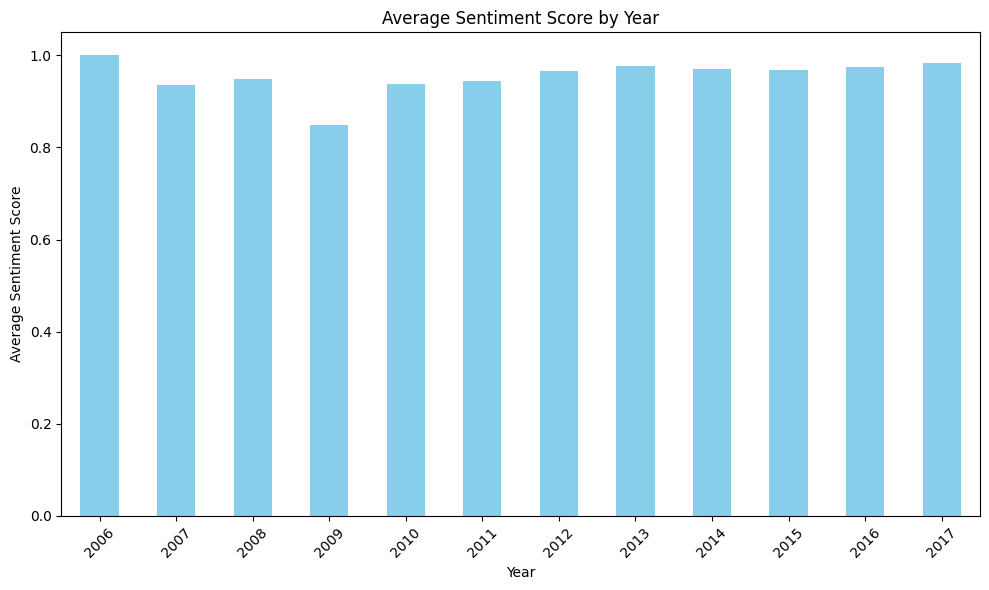

In [27]:
average_sentiment_by_year = all_data.groupby('meeting_year')['compound_sentiment'].mean()

plt.figure(figsize=(10, 6))
average_sentiment_by_year.plot(kind='bar', color='skyblue')
plt.title('Average Sentiment Score by Year')
plt.xlabel('Year')
plt.ylabel('Average Sentiment Score')
plt.xticks(rotation=45)
plt.tight_layout()

plt.show()

In [36]:
average_sentiment_by_state_year = all_data.groupby(['state_name', 'meeting_year'])['compound_sentiment'].mean().reset_index()
fig = px.scatter_3d(average_sentiment_by_state_year, x='meeting_year', y='state_name', z='compound_sentiment',
                    color='compound_sentiment', opacity=0.7,
                    title='Sentiment by State and Year',
                    labels={'meeting_year': 'Year', 'state_name': 'State', 'compound_sentiment': 'Sentiment Score'})

fig.show()


## Topic Word Cloud:
 Generate a word cloud visualization to showcase the most frequently discussed topics in public meetings

In this code, relevant columns were extracted from various dataframes using the `take_relvent_colls()` function and merged into a dataframe. After importing necessary libraries including pandas, string, nltk, sklearn, and wordcloud, stopwords were downloaded from the NLTK corpus. The `preprocess_text()` function was defined to remove punctuation, convert text to lowercase, and eliminate stopwords. For each dataframe df in the rel dictionary, rows with missing values were dropped. The `'vid_desc', 'vid_title'`, and `'caption_text_clean'` columns were concatenated into text_data after preprocessing. A WordCloud was generated from the preprocessed text_data using the WordCloud library, with customization of parameters for width, height, and background color. This produced word clouds based on concatenated textual data from the `'vid_desc', 'vid_title'`, and `'caption_text_clean'` columns for each dataframe in the rel dictionary, offering a visual representation of the most frequent words in the combined text.






In [50]:
rel = take_relvent_colls(dfs,['vid_desc','vid_title','caption_text_clean'])

In [51]:
dfs_in_detail(rel)

meetings.2008.csv
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 106 entries, 0 to 105
Data columns (total 3 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   vid_desc            105 non-null    object
 1   vid_title           106 non-null    object
 2   caption_text_clean  54 non-null     object
dtypes: object(3)
memory usage: 2.6+ KB
-------------------------------------
meetings.2010.csv
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1684 entries, 0 to 1683
Data columns (total 3 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   vid_desc            1418 non-null   object
 1   vid_title           1684 non-null   object
 2   caption_text_clean  957 non-null    object
dtypes: object(3)
memory usage: 39.6+ KB
-------------------------------------
meetings.2009.csv
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 488 entries, 0 to 487
Data columns (total 3 colum

In [52]:
all_data = pd.concat(rel.values())

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
<ipython-input-53-c2053be21045>:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



meetings.2008.csv


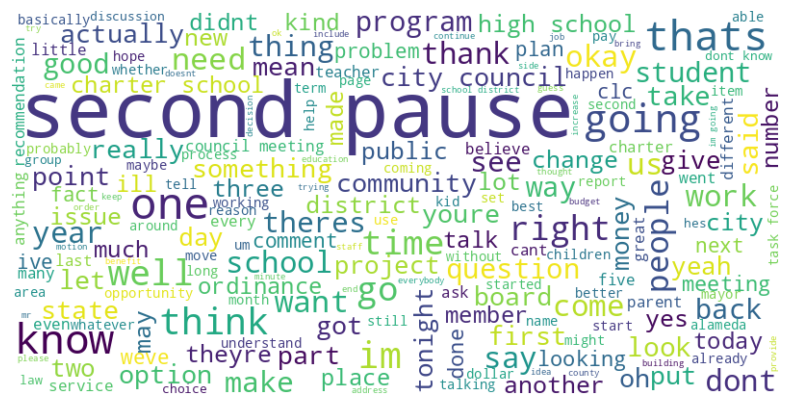

meetings.2010.csv


<ipython-input-53-c2053be21045>:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



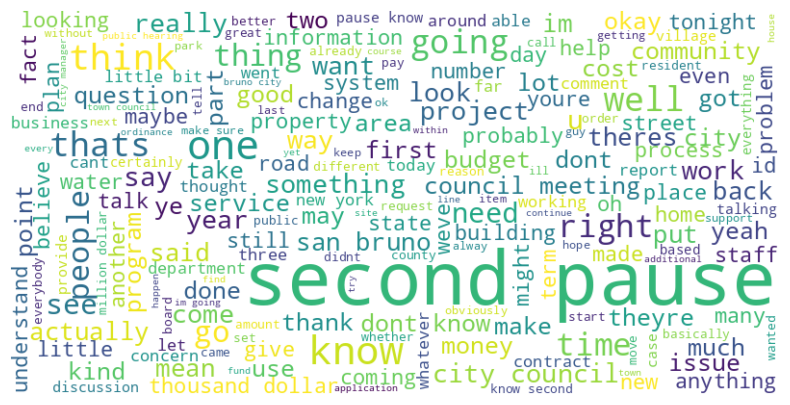

meetings.2009.csv


<ipython-input-53-c2053be21045>:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



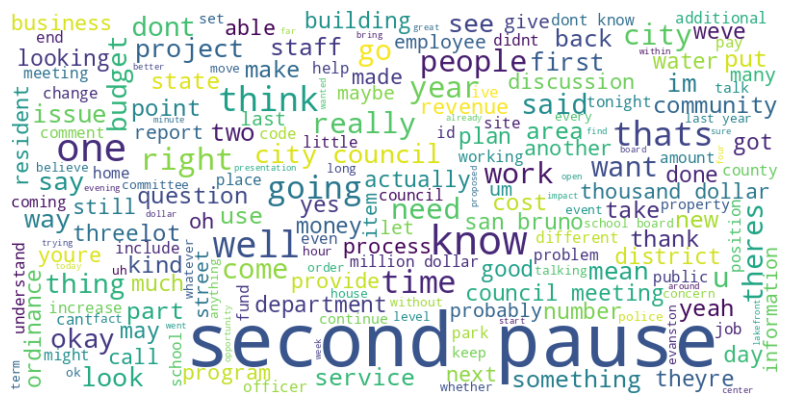

meetings.2012.csv


<ipython-input-53-c2053be21045>:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



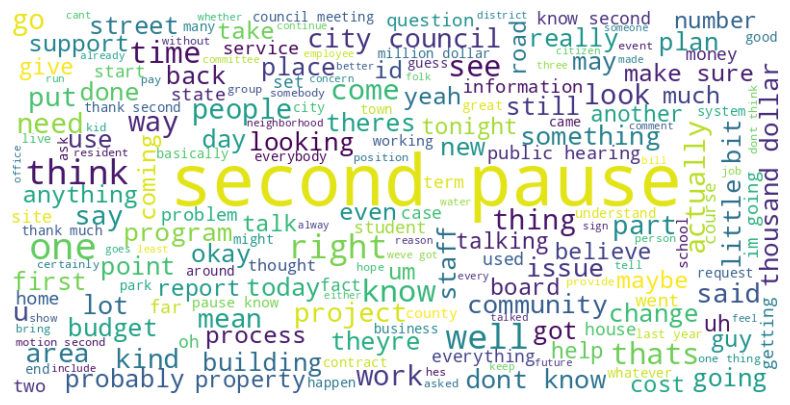

meetings.2017.csv


<ipython-input-53-c2053be21045>:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



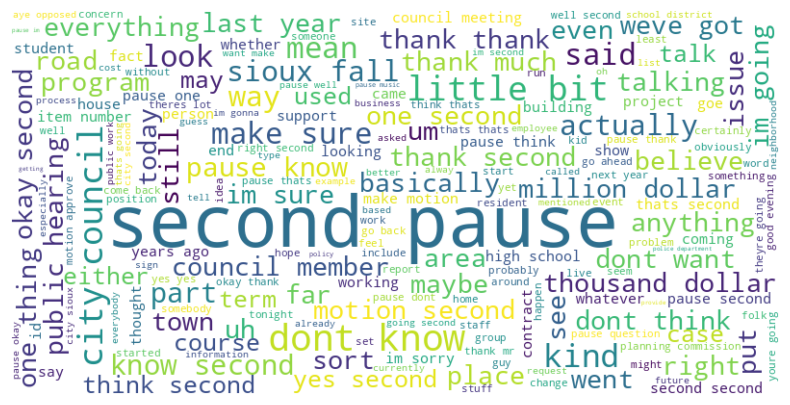

meetings.2011.csv


<ipython-input-53-c2053be21045>:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



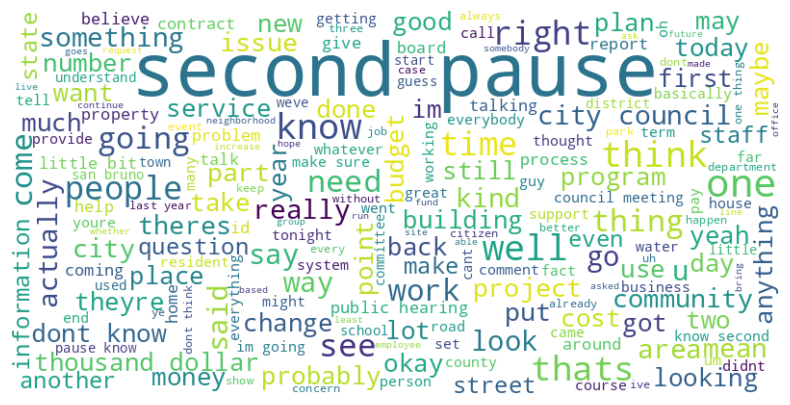

meetings.2013.csv


<ipython-input-53-c2053be21045>:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



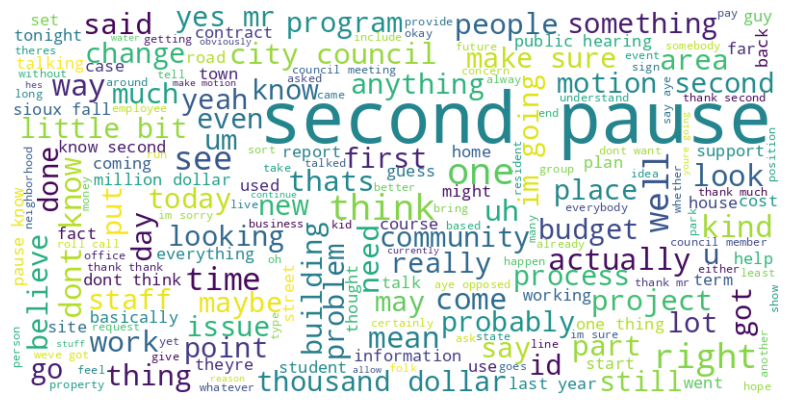

meetings.2006.csv


<ipython-input-53-c2053be21045>:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



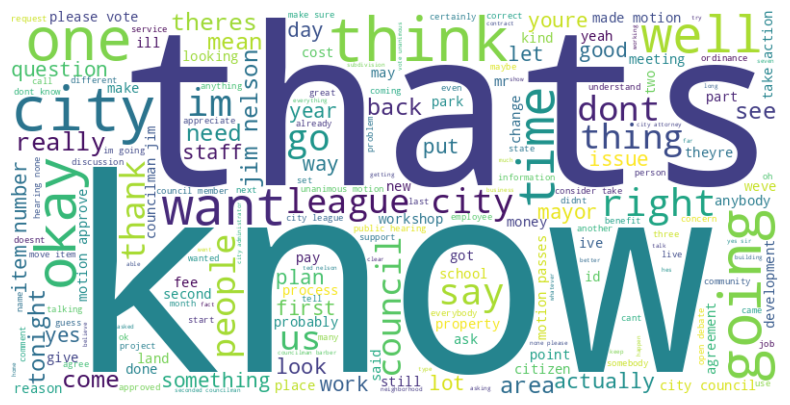

meetings.2007.csv


<ipython-input-53-c2053be21045>:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



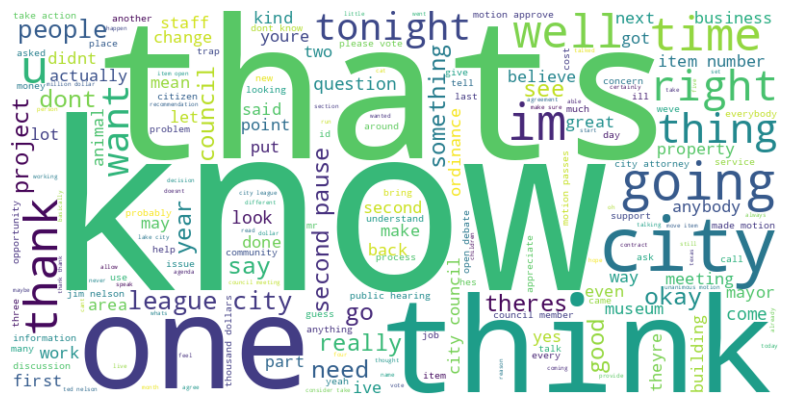

meetings.2014.csv


<ipython-input-53-c2053be21045>:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



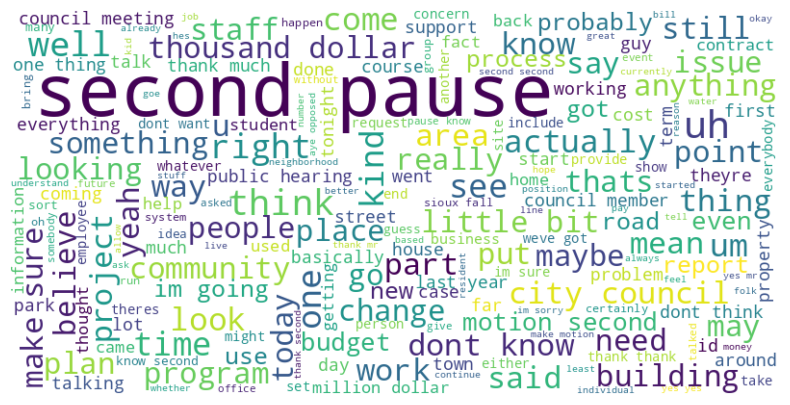

meetings.2016.csv


<ipython-input-53-c2053be21045>:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



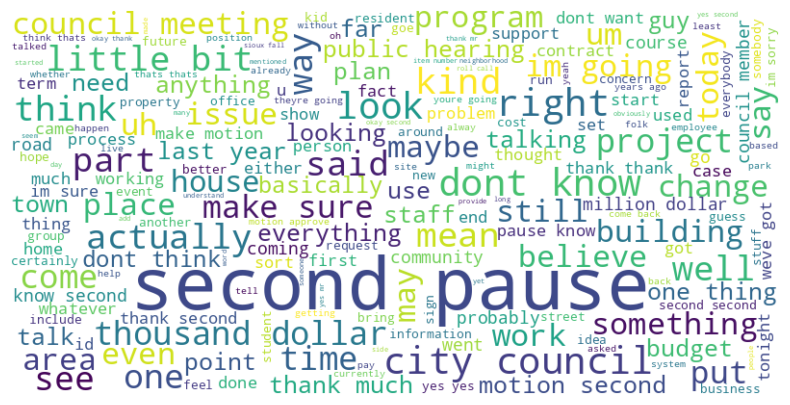

meetings.2015.csv


<ipython-input-53-c2053be21045>:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



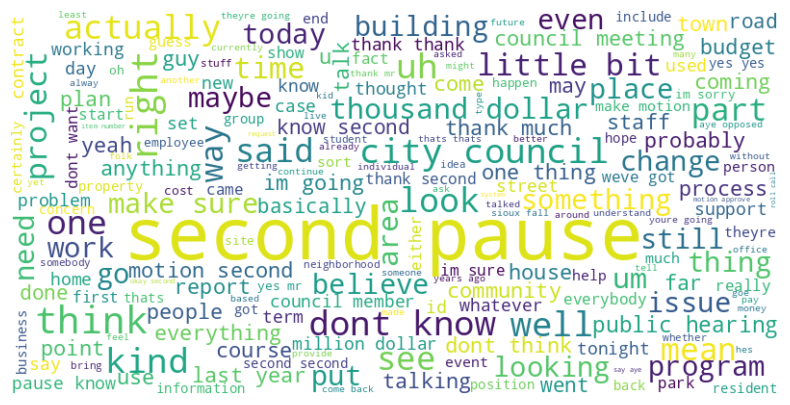

In [53]:
import pandas as pd
import string
import nltk
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from wordcloud import WordCloud
import matplotlib.pyplot as plt

nltk.download('stopwords')
stop_words = set(stopwords.words('english'))
def preprocess_text(text):
    text = text.translate(str.maketrans('', '', string.punctuation))
    text = text.lower()
    words = text.split()
    words = [word for word in words if word not in stop_words]
    return ' '.join(words)

for f, df in rel.items():
  print(f)
  df.dropna(subset=['vid_desc','vid_title','caption_text_clean'], inplace=True)
  if '2017' in f :
    df = df.sample(5000)
  text_data = df['vid_desc'].str.cat(sep=' ')
  text_data += " " + df['vid_title'].str.cat(sep=' ')
  text_data += " " + df['caption_text_clean'].str.cat(sep=' ')
  text_data = preprocess_text(text_data)
  wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text_data)
  plt.figure(figsize=(10, 5))
  plt.imshow(wordcloud, interpolation='bilinear')
  plt.axis('off')
  plt.show()


## Meeting Duration by Location:

In this code, relevant columns were extracted from multiple dataframes using the `take_relvent_colls()` function, and these columns were then concatenated into the all_data dataframe. Rows with missing values in `'state_name'` and `'vid_length_min'` were removed. The average duration of public meetings in each location (state) was calculated using `groupby()` and` mean()`, resulting in the `average_duration_by_location` dataframe. This dataframe was sorted in descending order by `'vid_length_min'`. The final visualization is presenting a clear comparison of average meeting durations across different states.

In [54]:
rel = take_relvent_colls(dfs,['state_name', 'vid_length_min'])
all_data = pd.concat(rel.values())
all_data.dropna(subset=[ 'state_name', 'vid_length_min'], inplace=True)

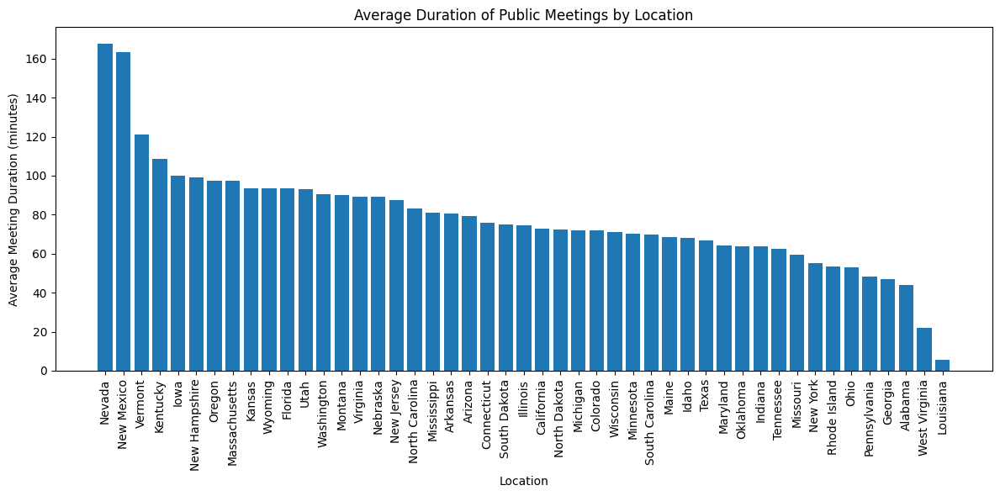

In [55]:
import pandas as pd
import matplotlib.pyplot as plt
average_duration_by_location = all_data.groupby('state_name')['vid_length_min'].mean().reset_index()

average_duration_by_location = average_duration_by_location.sort_values(by='vid_length_min', ascending=False)
plt.figure(figsize=(12, 6))
plt.bar(average_duration_by_location['state_name'], average_duration_by_location['vid_length_min'])
plt.xlabel('Location')
plt.ylabel('Average Meeting Duration (minutes)')
plt.title('Average Duration of Public Meetings by Location')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

##Meeting Location Heatmap:
In this code, relevant columns were selected from different dataframes using the `take_relvent_colls()` function, and these columns were combined into the all_data dataframe. Rows with missing values in `'st_fips', 'state_name','meeting_date'` were removed. The number of meetings for each state was calculated, leading to the `meeting_counts` dataframe. Afterthat we created the dataframe `heatmap_data`. Using the Seaborn library's `sns.heatmap()`, a heatmap was created with annotations, color mapping, and a title. The y-axis represented states, while the x-axis displayed meeting density.

In [69]:
rel = take_relvent_colls(dfs,['st_fips', 'state_name','meeting_date'])
all_data = pd.concat(rel.values())
all_data.dropna(subset=[ 'st_fips', 'state_name','meeting_date'], inplace=True)

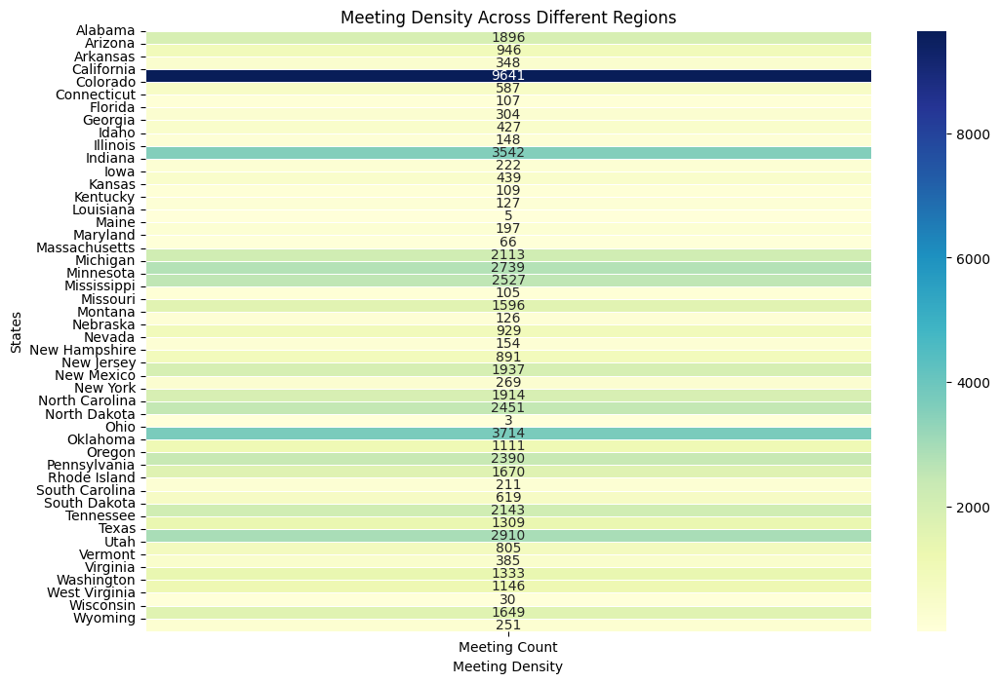

In [72]:
meeting_counts = all_data.groupby('state_name')['meeting_date'].count()
meeting_counts = meeting_counts.reset_index()
meeting_counts.rename(columns={'meeting_date': 'Meeting Count'}, inplace=True)
heatmap_data = pd.pivot_table(meeting_counts, values='Meeting Count', index='state_name')

plt.figure(figsize=(12, 8))
sns.heatmap(heatmap_data, annot=True, cmap='YlGnBu', fmt='g', linewidths=0.5)
plt.title('Meeting Density Across Different Regions')
plt.ylabel('States')
num_states = heatmap_data.shape[0]
plt.yticks(range(num_states), heatmap_data.index)
plt.xlabel('Meeting Density')
plt.show()

## Meeting Duration and Engagement:
In this code , relevant columns were selected from various dataframes using the `take_relvent_colls()` function, and these columns were merged into the all_data dataframe. Rows with missing values in engagement-related columns were dropped. Meeting durations were categorized into bins using `pd.cut()` and stored in a new column named `'meeting_duration_category'`. Engagement metrics like video views, likes, and comments were averaged and median-calculated based on meeting duration categories. The visualizations start with two grouped bar plots showing average engagement metrics (likes and comments) against meeting duration categories. Heatmaps were created using Seaborn for the correlation between median and average meeting duration with engagement metrics. Finally, correlations between meeting duration and engagement metrics were calculated and visualized as a heatmap.

In [73]:
rel = take_relvent_colls(dfs,['vid_views', 'vid_likes', 'vid_comments', 'vid_length_min','meeting_date'])
all_data = pd.concat(rel.values())
all_data.dropna(subset=[ 'vid_views', 'vid_likes', 'vid_comments', 'vid_length_min','meeting_date'], inplace=True)

In [74]:

meeting_duration_bins = [0, 15, 30, 45, 60, 90, 120, float('inf')]
all_data['meeting_duration_category'] = pd.cut(all_data['vid_length_min'], bins=meeting_duration_bins)


In [75]:
all_data.head()

,vid_views,vid_likes,vid_comments,vid_length_min,meeting_date,meeting_duration_category
0,6.0,0.0,0.0,3.816667,2008-08-30,"(0.0, 15.0]"
1,190.0,0.0,0.0,0.700000,2008-04-22,"(0.0, 15.0]"
2,629.0,0.0,0.0,2.600000,2008-05-06,"(0.0, 15.0]"
3,188.0,0.0,0.0,0.483333,2008-05-06,"(0.0, 15.0]"
4,522.0,0.0,0.0,0.733333,2008-05-06,"(0.0, 15.0]"


In [76]:
engagement_metrics = ['vid_views', 'vid_likes', 'vid_comments']
avg_engagement_by_duration = all_data.groupby('meeting_duration_category')[engagement_metrics].mean()
median_engagement_by_duration = all_data.groupby('meeting_duration_category')[engagement_metrics].median()

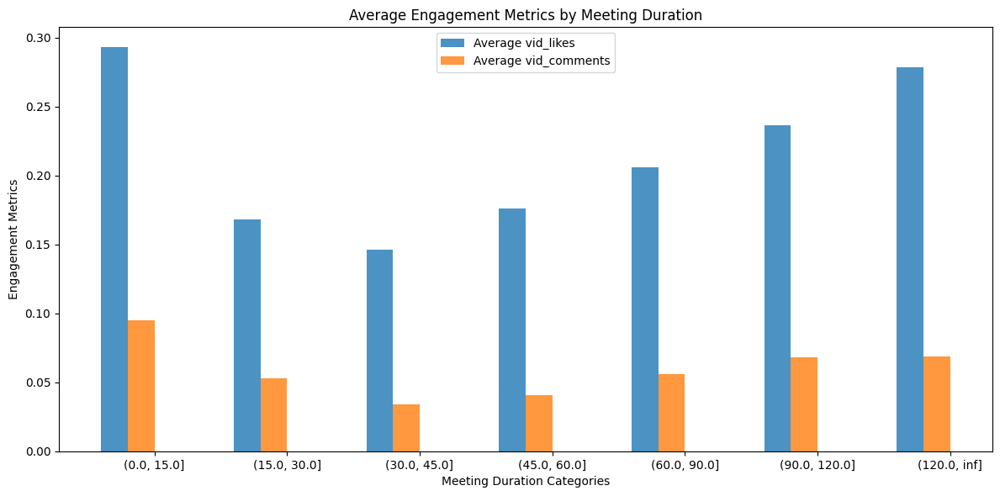

In [77]:
import numpy as np
plt.figure(figsize=(12, 6))
bar_width = 0.2
opacity = 0.8
engagement_metrics = [ 'vid_likes', 'vid_comments']
num_metrics = len(engagement_metrics)
x_labels = avg_engagement_by_duration.index

for i, metric in enumerate(engagement_metrics):
    x_offset = (i - num_metrics/2) * bar_width

    plt.bar(
        np.arange(len(x_labels)) + x_offset,
        avg_engagement_by_duration[metric],
        bar_width,
        alpha=opacity,
        label=f'Average {metric}'
    )

plt.xlabel('Meeting Duration Categories')
plt.ylabel('Engagement Metrics')
plt.title('Average Engagement Metrics by Meeting Duration')
plt.xticks(np.arange(len(x_labels)) + (num_metrics-1) * bar_width / 2, x_labels)
plt.legend()
plt.tight_layout()
plt.show()


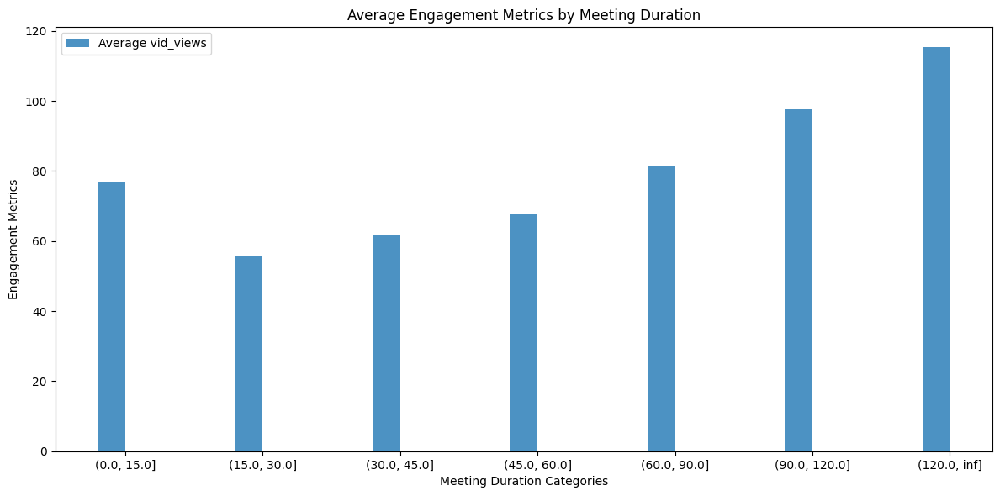

In [79]:
import numpy as np
plt.figure(figsize=(12, 6))
bar_width = 0.2
opacity = 0.8

engagement_metrics = [ 'vid_views']
num_metrics = len(engagement_metrics)
x_labels = avg_engagement_by_duration.index

for i, metric in enumerate(engagement_metrics):
    x_offset = (i - num_metrics/2) * bar_width

    plt.bar(
        np.arange(len(x_labels)) + x_offset,
        avg_engagement_by_duration[metric],
        bar_width,
        alpha=opacity,
        label=f'Average {metric}'
    )

plt.xlabel('Meeting Duration Categories')
plt.ylabel('Engagement Metrics')
plt.title('Average Engagement Metrics by Meeting Duration')
plt.xticks(np.arange(len(x_labels)) + (num_metrics-1) * bar_width / 2, x_labels)
plt.legend()
plt.tight_layout()
plt.show()


In [67]:
avg_engagement_by_duration

,vid_views,vid_likes,vid_comments
meeting_duration_category,,,
"(0.0, 15.0]",77.097872,0.293030,0.095231
"(15.0, 30.0]",55.947939,0.168198,0.052768
"(30.0, 45.0]",61.626265,0.145984,0.033863
"(45.0, 60.0]",67.605317,0.175869,0.040673
"(60.0, 90.0]",81.328769,0.206232,0.056029
"(90.0, 120.0]",97.586336,0.236464,0.067927
"(120.0, inf]",115.317789,0.278700,0.068989


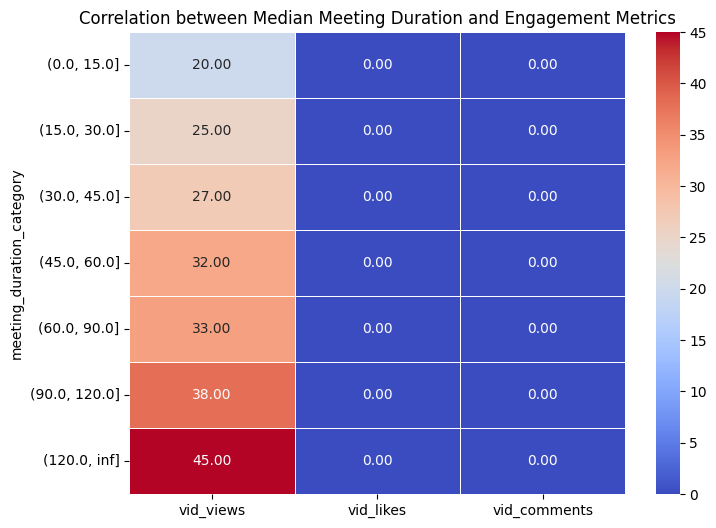

In [80]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
sns.heatmap(median_engagement_by_duration, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title("Correlation between Median Meeting Duration and Engagement Metrics")
plt.show()

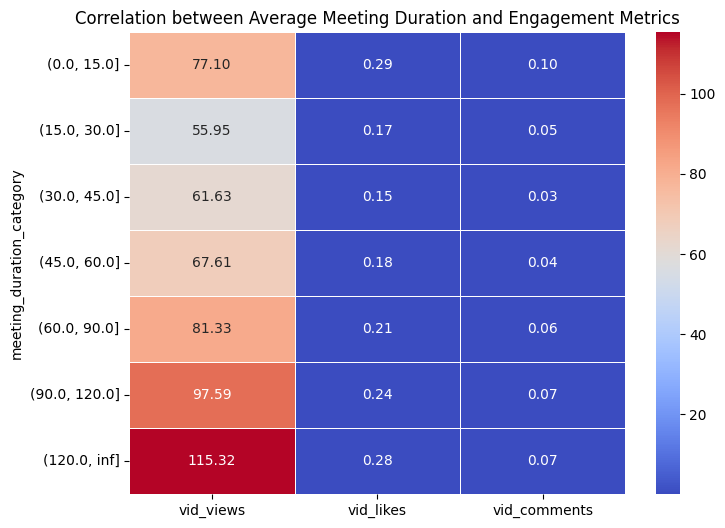

In [81]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
sns.heatmap(avg_engagement_by_duration, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title("Correlation between Average Meeting Duration and Engagement Metrics")
plt.show()

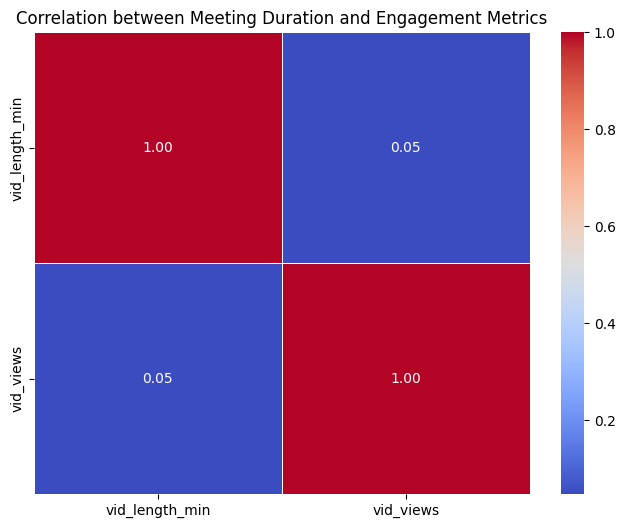

In [66]:
correlations = all_data[['vid_length_min'] + engagement_metrics].corr()
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
sns.heatmap(correlations, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title("Correlation between Meeting Duration and Engagement Metrics")
plt.show()
